# Set up

# spell-sound association picker

developed by Kow Kurooda (kow.kuroda@gmail.com)

Modifications
2025/03/01 added processing using extended skippy n-gram

# Spell-Sound HDP/LDA analyzer

developed by Kow Kuroda (kow.kuroda@gmail.com)

modifications

- 2025/07/31 i) refactored;

In [40]:
## prepare packages
#%pip install -U pandas
#%pip install -U matplotlib
#%pip install -U gensim
#%pip install -U scipy
#%pip install -U pyLDAvis
#%pip install -U plotly
#%pip install -U 'nbformat>=4.2.0'
#%pip install -U multiprocess
#!conda update conda -y

In [41]:
## import modules
import os, sys
## maake accessible files on level immediately above 
sys.path.append(os.path.join(os.path.dirname("__file__"), ".."))
## import other modules
import re
import gzip, glob
import unicodedata
## https://stackoverflow.com/questions/41385708/multiprocessing-example-giving-attributeerror
#import multiprocessing as mp # fails on IPython environment
import multiprocess as mp # provides Pool

# Preparation 1

In [42]:
## parameters
verbose              = True
check                = False
save_results         = False
targets_csv          = True
reload_modules       = True

## source sampling
source_sampling      = True
source_sampling_rate = 0.1 # optimal values depend on kinds of source

## doc settings # The longer sentences become, the less precise pairing becomes
size_measures        = [ 'sp_size', 'sn_size' ]
size_measure         = size_measures[1]
print(f"size_measure: {size_measure}")

max_doc_size         = 11 # values larger than 10 take considerably longer to complete
print(f"max_doc_size: {max_doc_size}")

min_doc_size         =  5
print(f"min_doc_size: {min_doc_size}")

size_measure: sn_size
max_doc_size: 11
min_doc_size: 5


In [43]:
## preprocessing settings
lower_chars           = True
print(f"lower_chars: {lower_chars}")

strip_accents         = False
print(f"strip_accents: {strip_accents}")

## boundary marking
boundary_symbol      = '#'  # requires more processing resource
print(f"boudary_symbol: {boundary_symbol}")

mark_boundaries       = True
print(f"mark_boundaries: {mark_boundaries}")
if mark_boundaries:
    hash_status = ""
else:
    hash_status = "-hashed"
print(f"hash_status: '{hash_status}'")

lower_chars: True
strip_accents: False
boudary_symbol: #
mark_boundaries: True
hash_status: ''


In [44]:
## term settings
ngram_is_inclusive    = True # takes longer to complete
print(f"ngram_is_inclusive: {ngram_is_inclusive}")

inclusion_degree      = 1    # Valid values are {0, 1, 2, ..., None}. With k, n-grams includes (n-k)-grams
print(f"inclusion_degree: {inclusion_degree}")

ngram_is_inclusive: True
inclusion_degree: 1


In [45]:
## skippy n-gram
skippy_means_extended = True
print(f"skippy_means_extended: {skippy_means_extended}")

## 隙間を表わす記号
gap_mark            = "…"
print(f"gap_mark: '{gap_mark}'")

max_gap_size_factor   = 0.33 # larger values take more time to process
print(f"max_gap_size_factor: {max_gap_size_factor}")

max_gap_size          = round(max_doc_size * max_gap_size_factor) # This needs to be smaller than other cases.
print(f"max_gap_size: {max_gap_size}")

skippy_means_extended: True
gap_mark: '…'
max_gap_size_factor: 0.33
max_gap_size: 4


In [46]:
## spell term と sound term の連結記号
pair_mark           = " :: "

## spell
if skippy_means_extended:
    sp_term_types  = [ 'sp_1g',
                      'sp_2g', 'sp_3g', 'sp_4g', 'sp_5g',
                      'sp_xsk2g', 'sp_xsk3g', 'sp_xsk4g', 'sp_xsk5g' ]
else:
    sp_term_types  = [ 'sp_1g',
                  'sp_2g', 'sp_3g', 'sp_4g', 'sp_5g',
                 'sp_sk2g', 'sp_sk3g', 'sp_sk4g', 'sp_sk5g' ]
##
print(f"sp_term_types: {sp_term_types}")

## sound
if skippy_means_extended:
    sn_term_types = [ 'sn_1g',
                 'sn_2g', 'sn_3g', 'sn_4g', 'sn_5g',
                 'sn_xsk2g', 'sn_xsk3g', 'sn_xsk4g', 'sn_xsk5g' ]
else:
    sn_term_types = [ 'sn_1g',
                 'sn_2g', 'sn_3g', 'sn_4g', 'sn_5g',
                 'sn_sk2g', 'sn_sk3g', 'sn_sk4g', 'sn_sk5g' ]

## filter
if skippy_means_extended:
    sp_term_types = [ t for t in sp_term_types if not "_sk" in t ]
    sn_term_types = [ t for t in sn_term_types if not "_sk" in t ]
else:
    sp_term_types = [ t for t in sp_term_types if not "_xsk" in t ]
    sn_term_types = [ t for t in sn_term_types if not "_xsk" in t ]
##
print(f"sn_term_types: {sn_term_types}")

sp_term_types: ['sp_1g', 'sp_2g', 'sp_3g', 'sp_4g', 'sp_5g', 'sp_xsk2g', 'sp_xsk3g', 'sp_xsk4g', 'sp_xsk5g']
sn_term_types: ['sn_1g', 'sn_2g', 'sn_3g', 'sn_4g', 'sn_5g', 'sn_xsk2g', 'sn_xsk3g', 'sn_xsk4g', 'sn_xsk5g']


In [47]:
## select terms
sp_term_type   = sp_term_types[-3]
print(f"sp_term_type: {sp_term_type}")

sn_term_type = sn_term_types[-3]
print(f"sn_term_type: {sn_term_type}")

## set max_n_for_ngram
n_sp = sp_term_type.split("g")[0][-1]
n_sn = sn_term_type.split("g")[0][-1]
max_n_for_ngram = max(int(n_sp), int(n_sn))
print(f"max_n_for_ngram: {max_n_for_ngram}")

sp_term_type: sp_xsk3g
sn_term_type: sn_xsk3g
max_n_for_ngram: 3


In [48]:
## select language and file
lang_names = {  'ar' : 'Arabic',  # 0
                'de' : 'German',  # 1
                'en' : 'English', # 2
                'es' : 'Spanish', # 3
                'fr' : 'French',  # 4
                'sw' : 'Swahili', # 5
                'ir' : 'Irish'    # 6
            }
## selection
lang_keys = [ 'ar', 'de', 'en', 'es', 'fr', 'sw', 'ir' ]
#
target_lang_key  = lang_keys[-1]
lang_name = lang_names[target_lang_key]
target_lang_attr = ""
print(f"lang_name: {lang_name} ({target_lang_attr}) [lang_key: {target_lang_key}]")
# aliases
target_lang_dict = lang_names
print(f"target_lang_dict: {target_lang_dict}")
target_lang_keys = lang_keys
print(f"target_lang_keys: {target_lang_keys}")
target_lang_key  = target_lang_key
print(f"target_lang_key: {target_lang_key}")
target_lang_attr = target_lang_attr
print(f"target_lang_attr: {target_lang_attr}")

lang_name: Irish () [lang_key: ir]
target_lang_dict: {'ar': 'Arabic', 'de': 'German', 'en': 'English', 'es': 'Spanish', 'fr': 'French', 'sw': 'Swahili', 'ir': 'Irish'}
target_lang_keys: ['ar', 'de', 'en', 'es', 'fr', 'sw', 'ir']
target_lang_key: ir
target_lang_attr: 


In [49]:
## get data
import glob
data_dir1 = "data/open-dict-ipa/data1"
data_dir2 = "data/open-dict-ipa/data1a"
data_dir3 = "data/custom-ipa/"

data_files = [ ]
for dir in [ data_dir1, data_dir2, data_dir3 ]:
    gz_files = glob.glob(f"{dir}/*.gz")
    data_files.extend(gz_files)
    csv_files = glob.glob(f"{dir}/*.csv")
    data_files.extend(csv_files)
    txt_files = glob.glob(f"{data_dir2}/*.txt")
    data_files.extend(txt_files)
#
data_files

['data/open-dict-ipa/data1/yue.csv.gz',
 'data/open-dict-ipa/data1/vi_S.csv.gz',
 'data/open-dict-ipa/data1/de.csv.gz',
 'data/open-dict-ipa/data1/jam.csv.gz',
 'data/open-dict-ipa/data1/ro.csv.gz',
 'data/open-dict-ipa/data1/fa.csv.gz',
 'data/open-dict-ipa/data1/zh_hant.csv.gz',
 'data/open-dict-ipa/data1/sw.csv.gz',
 'data/open-dict-ipa/data1/ar.csv.gz',
 'data/open-dict-ipa/data1/es_MX.csv.gz',
 'data/open-dict-ipa/data1/vi_C.csv.gz',
 'data/open-dict-ipa/data1/ma.csv.gz',
 'data/open-dict-ipa/data1/fi.csv.gz',
 'data/open-dict-ipa/data1/eo.csv.gz',
 'data/open-dict-ipa/data1/fr_QC.csv.gz',
 'data/open-dict-ipa/data1/es_ES.csv.gz',
 'data/open-dict-ipa/data1/en_US.csv.gz',
 'data/open-dict-ipa/data1/en_UK.csv.gz',
 'data/open-dict-ipa/data1/nb.csv.gz',
 'data/open-dict-ipa/data1/nl.csv.gz',
 'data/open-dict-ipa/data1/sv.csv.gz',
 'data/open-dict-ipa/data1/or.csv.gz',
 'data/open-dict-ipa/data1/zh_hans.csv.gz',
 'data/open-dict-ipa/data1/fr_FR.csv.gz',
 'data/open-dict-ipa/data1/vi_

In [50]:
## filter files
data_files = [ file for file in data_files if f"/{target_lang_key}" in file ]
print(data_files)
if len(target_lang_attr) > 0:
    print(f"lang_attr: {target_lang_attr}")
    selected_files = [ file for file in data_files if target_lang_attr in file ]
else:
    selected_files = data_files
#
selected_files
if len(selected_files) == 0:
    exit()

['data/custom-ipa/ir.csv']


In [51]:
## build data from files
import re, unicodedata
import pandas as pd

check = False
target_file = selected_files[0]
col_names = [ 'sp_word', 'sn_word' ]
if target_file.endswith(".gz"):
    with gzip.open(target_file, "rt") as f:
        raw_df = pd.read_csv(f, encoding = 'utf8', header = None, names = col_names )
else:
    with open(target_file, "rt") as f:
        raw_df = pd.read_csv(f, encoding = 'utf8', header = None, names = col_names )
#
raw_df

,sp_word,sn_word
0,díogach,diːɡəx
1,corróg,kɔrˠɔɡ
2,sioc-cheo,sɔːk-xɔː
3,slat,slat
4,geimhleach,ɡɛɪvlæx
...,...,...
1195,gastacht,ɡastaxt
1196,braicheadóir,braːxædɔɪr
1197,sann,sanˠ
1198,cúlchraos,kʊlxraɔs


In [52]:
## modify spell
norm_code = 'NFKC'
raw_df['sp_word'] = raw_df['sp_word'].apply(lambda x: unicodedata.normalize(norm_code, str(x)))
if lower_chars:
    raw_df['sp_word'] = raw_df['sp_word'].apply(lambda x: x.lower())

## modify sound symbols
raw_df['sn_word'] = raw_df['sn_word'].apply(lambda x: unicodedata.normalize(norm_code, str(x)))
raw_df['sn_word'] = raw_df['sn_word'].apply(lambda x: re.sub(r"/", "", x))
raw_df['sn_word'] = raw_df['sn_word'].apply(lambda x: x.split(",")[0]) # pick up only the first
if strip_accents:
    raw_df['sn_word'] = raw_df['sn_word'].apply(lambda x: re.sub(r'"', "", x))
    raw_df['sn_word'] = raw_df['sn_word'].apply(lambda x: re.sub(r"[ˈˌ]", "", x))
#
raw_df

,sp_word,sn_word
0,díogach,diːɡəx
1,corróg,kɔrɣɔɡ
2,sioc-cheo,sɔːk-xɔː
3,slat,slat
4,geimhleach,ɡɛɪvlæx
...,...,...
1195,gastacht,ɡastaxt
1196,braicheadóir,braːxædɔɪr
1197,sann,sanɣ
1198,cúlchraos,kʊlxraɔs


In [53]:
## build df
dids = [ ]
sids = [ ]
Spells = [ ]
Sounds = [ ]
for i, row in raw_df.iterrows():
    spell = row['sp_word']
    sound = row['sn_word']
    if len(spell) > 0 and len(sound) > 0:
        dids.append(i + 1)
        sids.append(i + 1)
        Spells.append(spell)
        Sounds.append(sound)
#
var_names = [ 'did', 'sid', 'sp_word', 'sn_word',
            'sp_size', 'sn_size', 'paired_terms', 
            'sp_1g', 'sp_2g', 'sp_3g',
            'sp_sk2g', 'sp_sk3g',
            'sn_1g', 'sn_2g', 'sn_3g', 
            'sn_sk2g', 'sn_sk3g' ]
df = pd.DataFrame()
df['did'] = dids
df['sid'] = sids
df['sp_word'] = Spells
df['sn_word'] = Sounds
#
df[var_names[:4]]

,did,sid,sp_word,sn_word
0,1,1,díogach,diːɡəx
1,2,2,corróg,kɔrɣɔɡ
2,3,3,sioc-cheo,sɔːk-xɔː
3,4,4,slat,slat
4,5,5,geimhleach,ɡɛɪvlæx
...,...,...,...,...
1195,1196,1196,gastacht,ɡastaxt
1196,1197,1197,braicheadóir,braːxædɔɪr
1197,1198,1198,sann,sanɣ
1198,1199,1199,cúlchraos,kʊlxraɔs


In [54]:
# filter hyphenated words
len1 = len(df)
df = df[ df['sp_word'].apply(lambda x: x.find("-")) < 0 ]
print(f"discarded {len1- len(df)} rows")

discarded 21 rows


In [55]:
## remove diacritics on sound
removal = r"[ˈˌ ̯'̯]"
df['sn_word'] = df['sn_word'].apply(lambda x: re.sub(removal, "", x))

In [56]:
## tokenization
import gzip, re
import pandas as pd
check = False
Snx = [ ]
Spx = [ ]
for i, row in df.iterrows():
    Spt = row['sp_word']
    Snt = row['sn_word']
    split_pattern = r""
    ## Spell
    sp_seg = [ x for x in re.split(split_pattern, Spt) if len(x) > 0 ]
    if check:
        print(sp_seg)
    Spx.append(sp_seg)
    ## Sound
    sn_seg = [ x for x in re.split(split_pattern, Snt) if len(x) > 0 ]
    if check:
        print(sn_seg)
    Snx.append(sn_seg)
## Spell
try:
    df['sp_1g'] = Spx
except ValueError:
    pass
## Sound
try:
    df['sn_1g'] = Snx
except ValueError:
    pass
## check result
df[['sp_1g', 'sn_1g']]

,sp_1g,sn_1g
0,"[d, í, o, g, a, c, h]","[d, i, ː, ɡ, ə, x]"
1,"[c, o, r, r, ó, g]","[k, ɔ, r, ɣ, ɔ, ɡ]"
3,"[s, l, a, t]","[s, l, a, t]"
4,"[g, e, i, m, h, l, e, a, c, h]","[ɡ, ɛ, ɪ, v, l, æ, x]"
5,"[b, a, i, t, í, n, e, a, c, h]","[b, a, ː, t, ɪ, n, æ, x]"
...,...,...
1195,"[g, a, s, t, a, c, h, t]","[ɡ, a, s, t, a, x, t]"
1196,"[b, r, a, i, c, h, e, a, d, ó, i, r]","[b, r, a, ː, x, æ, d, ɔ, ɪ, r]"
1197,"[s, a, n, n]","[s, a, n, ɣ]"
1198,"[c, ú, l, c, h, r, a, o, s]","[k, ʊ, l, x, r, a, ɔ, s]"


In [57]:
## add size columns
df['sp_size'] = df['sp_1g'].apply(lambda x: len(x))
df['sn_size'] = df['sn_1g'].apply(lambda x: len(x))
if verbose:
    df

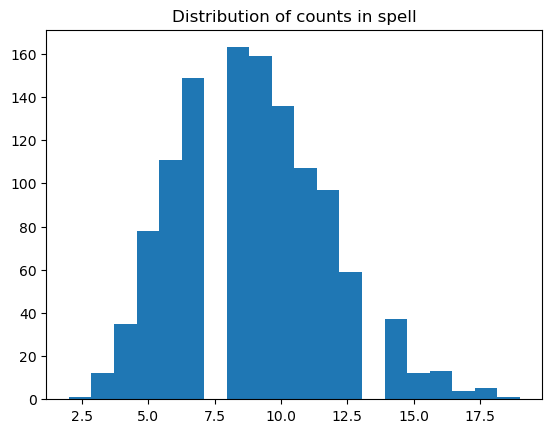

In [58]:
## 語の綴り文字数の分布
import matplotlib.pyplot as plt
plt.hist(df['sp_size'], bins = 20)
plt.title(f"Distribution of counts in spell")
plt.show()

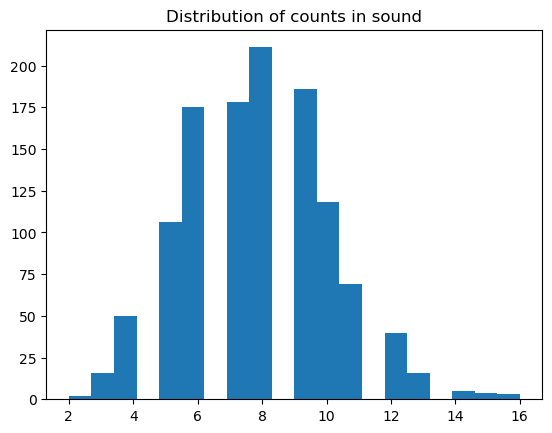

In [59]:
## 語の発音記号数の分布
import matplotlib.pyplot as plt
plt.hist(df['sn_size'], bins = 20)
plt.title(f"Distribution of counts in sound")
plt.show()

In [60]:
## sampling
max_source_size = 2000
original_size = len(df)
print(f"original_size: {original_size}")
if source_sampling and original_size >= max_source_size:
    sample_size   = round(len(df) * source_sampling_rate)
    df = df.sample(sample_size)
    print(f"sampled {len(df)} ({source_sampling_rate:0.3f}) rows by discarding {original_size - len(df)} rows")

original_size: 1179


# build terms, part 1

In [61]:
## 長さで濾過
original_size = len(df)
print(f"discarding pairs whose {size_measure} part has less than {min_doc_size} chars")
df = df[df[size_measure] >= min_doc_size]

print(f"discarding pairs whose {size_measure} part has more than {max_doc_size} chars")
df = df[df[size_measure] < max_doc_size]

current_size = len(df)
size_diff = original_size - current_size
print(f"{size_diff} ({size_diff/original_size:.3f}) pairs were removed")
print(f"{current_size} pairs remain")

discarding pairs whose sn_size part has less than 5 chars
discarding pairs whose sn_size part has more than 11 chars
205 (0.174) pairs were removed
974 pairs remain


In [62]:
## add boundaries
def add_boundary_symbols (x):
    if x[0] == boundary_symbol and x[-1] == boundary_symbol:
        return x
    else:
        return f"{boundary_symbol}{x}{boundary_symbol}"

In [63]:
if mark_boundaries:
    df['sp_word'] = df['sp_word'].apply(lambda x: add_boundary_symbols (x))
    df['sn_word'] = df['sn_word'].apply(lambda x: add_boundary_symbols (x))
    df[['sp_word', 'sn_word']]

In [64]:
## generate 1-gram
import re
w_splitter = r""
from unicodedata import normalize as norm
norm_code = "NFKC"

#df['sp_1g'] = [ [ x for x in re.split(w_splitter, w) if len(x) > 0 ] for w in df['sp_word'] ]
df['sp_1g'] = df['sp_word'].apply(lambda w:
                                     [ x for x in re.split(w_splitter, norm(norm_code, w)) if len(x) > 0 ])
#df['sn_1g'] = [ [ x for x in re.split(w_splitter, w) if len(x) > 0 ] for w in df['sn_word'] ]
df['sn_1g'] = df['sn_word'].apply(lambda w:
                                     [ x for x in re.split(w_splitter, norm(norm_code, w)) if len(x) > 0 ])
#
df[['sp_1g', 'sn_1g']]

,sp_1g,sn_1g
0,"[#, d, í, o, g, a, c, h, #]","[#, d, i, ː, ɡ, ə, x, #]"
1,"[#, c, o, r, r, ó, g, #]","[#, k, ɔ, r, ɣ, ɔ, ɡ, #]"
4,"[#, g, e, i, m, h, l, e, a, c, h, #]","[#, ɡ, ɛ, ɪ, v, l, æ, x, #]"
5,"[#, b, a, i, t, í, n, e, a, c, h, #]","[#, b, a, ː, t, ɪ, n, æ, x, #]"
6,"[#, n, e, a, m, h, c, h, ú, t, h, a, i, l, #]","[#, n, æ, v, x, ʊ, h, a, ː, l, #]"
...,...,...
1193,"[#, a, i, s, c, h, é, i, m, n, i, g, h, #]","[#, a, ː, s, x, ɛ, ɪ, m, n, ɪ, ɣ, #]"
1195,"[#, g, a, s, t, a, c, h, t, #]","[#, ɡ, a, s, t, a, x, t, #]"
1196,"[#, b, r, a, i, c, h, e, a, d, ó, i, r, #]","[#, b, r, a, ː, x, æ, d, ɔ, ɪ, r, #]"
1198,"[#, c, ú, l, c, h, r, a, o, s, #]","[#, k, ʊ, l, x, r, a, ɔ, s, #]"


In [65]:
## inspect frequent tokens in sp_1g
from collections import Counter
sp_chars_all = [ ] 
[ sp_chars_all.extend(list(x)) for x in df['sp_1g'] ]
sp_char_freqs = Counter(sp_chars_all)

## show most frequent 10 segments
sp_char_freqs.most_common(10)

[('#', 1948),
 ('a', 1216),
 ('h', 761),
 ('i', 752),
 ('c', 674),
 ('r', 547),
 ('n', 486),
 ('l', 473),
 ('t', 427),
 ('e', 419)]

In [66]:
## inspect frequent tokens in sn_1g
from collections import Counter
sn_chars_all = [ ] 
[ sn_chars_all.extend(list(x)) for x in df['sn_1g'] ]
sn_char_freqs = Counter(sn_chars_all)

## show most frequent 10 segments
sn_char_freqs.most_common(10)

[('#', 1948),
 ('a', 1092),
 ('ɪ', 656),
 ('r', 530),
 ('ɔ', 440),
 ('n', 438),
 ('l', 428),
 ('x', 375),
 ('ː', 363),
 ('s', 362)]

In [67]:
## Install nltk if necessary
#!pip install -U nltk

n-grams の構築

In [68]:
def gen_ngrams_from_str (t: str, n: int, sep: str = r"", joint: str = "", check = False):
    'returns the list of character n-grams from a given string'
    
    import re
    import unicodedata
    segs = [ x for x in re.split(sep, unicodedata('NFKC', t)) if len(x) > 0 ]
    if check:
        print(segs)
    ## short input
    if len(segs) <= n:
        return segs
    
    ## long enough input
    G = [ ]
    for i in range(len(segs)):
        try:
            b = segs[ i : i + n ]
            if check:
                print(b)
            c = joint.join(b)
            if check:
                print(c)
            if len(c) == n:
                G.append(c)
        except IndexError:
            pass
    return G

In [69]:
import os
n_cores = max(int(os.cpu_count()/2) - 1, 1)

In [70]:

def add_ngrams (dfx, n_for_ngram: int, skippy: bool, skippy_means_extended: bool = False, prefix: str = "", n_cores: int = n_cores, max_distance: int = None, seg_joint: str = "", inclusive: bool = True, inclusion_degree = None, source_var_base: str = "1g", gap_mark: str = "…", check: bool = False):
    "add ngram col to the dfx given"
    import gen_ngrams
    
    ## set variable names
    source_var_name = f"{prefix}{source_var_base}"
    #
    if skippy_means_extended:
        skippiness_symbol: str = "xsk"
    else:
        skippiness_symbol: str = "sk" 
    #
    if skippy:
        target_var_name  = f"{prefix}{skippiness_symbol}{n_for_ngram}g"
        if n_for_ngram == 2:
            sub_var_name = f"{prefix}{n_for_ngram - 1}g"
        else:
            sub_var_name = f"{prefix}{skippiness_symbol}{n_for_ngram - 1}g"
            
    else:
        target_var_name  = f"{prefix}{n_for_ngram}g"
        sub_var_name     = f"{prefix}{n_for_ngram - 1}g"
    
    ## check names
    if check:
        print(f"source_var_name: {source_var_name}")
        print(f"target_var_name: {target_var_name}")
        print(f"sub_var_name: {sub_var_name}")
        
    ## 1gram
    unigrams = dfx[source_var_name]
    
    ## ngram
    import os
    import multiprocess as mp
    pool = mp.Pool (processes = n_cores)
    if skippy:
        if skippy_means_extended:
            ngrams = unigrams.apply(lambda x: gen_ngrams.gen_extended_skippy_ngrams(x, n = n_for_ngram, sep = seg_joint, missing_mark = gap_mark, max_distance = max_distance, check = check))
        else:
            ngrams = unigrams.apply(lambda x: gen_ngrams.gen_skippy_ngrams(x, n = n_for_ngram, sep = seg_joint, missing_mark = gap_mark, max_distance = max_distance, check = check))
        
    else:
        ngrams = unigrams.apply(lambda x: gen_ngrams.gen_ngrams(x, n = n_for_ngram, sep = seg_joint, check = check))
    
    ## make ngrams inclusive
    if inclusive:
        sub_ngrams = list(dfx[sub_var_name])
        if inclusion_degree is None:
            for i, gram in enumerate(ngrams):
                assert len(ngrams) == len(sub_ngrams)
                supplement = sub_ngrams[i]
                supplement = [ g for g in supplement if len(g) > 0 ]
                if len(supplement) > 0:
                    gram.extend(supplement)
        else:
            min_size = (n_for_ngram - inclusion_degree)
            assert min_size >= 0
            for i, gram in enumerate(ngrams):
                assert len(ngrams) == len(sub_ngrams)
                supplement = sub_ngrams[i]
                supplement = [ g for g in supplement if len(g) >= min_size ]
                if len(supplement) > 0:
                    gram.extend(supplement)
    ## update df
    dfx[target_var_name] = ngrams
    print(dfx[target_var_name])

# Spell n-grams 生成

In [71]:
df.columns

Index(['did', 'sid', 'sp_word', 'sn_word', 'sp_1g', 'sn_1g', 'sp_size',
       'sn_size'],
      dtype='object')

In [72]:
## sp_n-grams (n > 1)  の追加
for i in range(2, max_n_for_ngram + 1):
    add_ngrams (df, i, prefix = "sp_", skippy = False, inclusive = True, inclusion_degree = inclusion_degree, check = False)

0       [#d, dí, ío, og, ga, ac, ch, h#, #, d, í, o, g...
1       [#c, co, or, rr, ró, óg, g#, #, c, o, r, r, ó,...
4       [#g, ge, ei, im, mh, hl, le, ea, ac, ch, h#, #...
5       [#b, ba, ai, it, tí, ín, ne, ea, ac, ch, h#, #...
6       [#n, ne, ea, am, mh, hc, ch, hú, út, th, ha, a...
                              ...                        
1193    [#a, ai, is, sc, ch, hé, éi, im, mn, ni, ig, g...
1195    [#g, ga, as, st, ta, ac, ch, ht, t#, #, g, a, ...
1196    [#b, br, ra, ai, ic, ch, he, ea, ad, dó, ói, i...
1198    [#c, cú, úl, lc, ch, hr, ra, ao, os, s#, #, c,...
1199    [#c, cr, ro, ob, bh, ha, ar, r#, #, c, r, o, b...
Name: sp_2g, Length: 974, dtype: object
0       [#dí, dío, íog, oga, gac, ach, ch#, #d, dí, ío...
1       [#co, cor, orr, rró, róg, óg#, #c, co, or, rr,...
4       [#ge, gei, eim, imh, mhl, hle, lea, eac, ach, ...
5       [#ba, bai, ait, ití, tín, íne, nea, eac, ach, ...
6       [#ne, nea, eam, amh, mhc, hch, chú, hút, úth, ...
                              ..

In [73]:
## sp_sk-n-grams (n > 1)  の追加
for i in range(2, max_n_for_ngram + 1):
    add_ngrams(df, n_for_ngram = i, prefix = "sp_", skippy = True, skippy_means_extended = skippy_means_extended, max_distance = max_gap_size, inclusive = True, inclusion_degree = inclusion_degree, check = False)

0       [#d…, #…í…, #…o…, #…g…, …dí…, …d…o…, …d…g…, …í...
1       [#c…, #…o…, #…r…, #…r…, …co…, …c…r…, …c…r…, …o...
4       [#g…, #…e…, #…i…, #…m…, …ge…, …g…i…, …g…m…, …e...
5       [#b…, #…a…, #…i…, #…t…, …ba…, …b…i…, …b…t…, …a...
6       [#n…, #…e…, #…a…, #…m…, …ne…, …n…a…, …n…m…, …e...
                              ...                        
1193    [#a…, #…i…, #…s…, #…c…, …ai…, …a…s…, …a…c…, …i...
1195    [#g…, #…a…, #…s…, #…t…, …ga…, …g…s…, …g…t…, …a...
1196    [#b…, #…r…, #…a…, #…i…, …br…, …b…a…, …b…i…, …r...
1198    [#c…, #…ú…, #…l…, #…c…, …cú…, …c…l…, …c…c…, …ú...
1199    [#c…, #…r…, #…o…, #…b…, …cr…, …c…o…, …c…b…, …r...
Name: sp_xsk2g, Length: 974, dtype: object
0       [#…dí…, #…d…o…, #…d…g…, #…ío…, #…í…g…, #…og…, ...
1       [#…co…, #…c…r…, #…c…r…, #…or…, #…o…r…, #…r…, …...
4       [#…ge…, #…g…i…, #…g…m…, #…ei…, #…e…m…, #…im…, ...
5       [#…ba…, #…b…i…, #…b…t…, #…ai…, #…a…t…, #…it…, ...
6       [#…ne…, #…n…a…, #…n…m…, #…ea…, #…e…m…, #…am…, ...
                             

In [76]:
df.columns

Index(['did', 'sid', 'sp_word', 'sn_word', 'sp_1g', 'sn_1g', 'sp_size',
       'sn_size', 'sp_2g', 'sp_3g', 'sp_xsk2g', 'sp_xsk3g'],
      dtype='object')

# Sound n-grams 生成

In [77]:
## sn_n-grams (n > 1) の追加
for i in range(2, max_n_for_ngram + 1):
    add_ngrams(df, n_for_ngram = i, prefix = "sn_", skippy = False, inclusive = True, inclusion_degree = inclusion_degree, check = False)

0       [#d, di, iː, ːɡ, ɡə, əx, x#, #, d, i, ː, ɡ, ə,...
1       [#k, kɔ, ɔr, rɣ, ɣɔ, ɔɡ, ɡ#, #, k, ɔ, r, ɣ, ɔ,...
4       [#ɡ, ɡɛ, ɛɪ, ɪv, vl, læ, æx, x#, #, ɡ, ɛ, ɪ, v...
5       [#b, ba, aː, ːt, tɪ, ɪn, næ, æx, x#, #, b, a, ...
6       [#n, næ, æv, vx, xʊ, ʊh, ha, aː, ːl, l#, #, n,...
                              ...                        
1193    [#a, aː, ːs, sx, xɛ, ɛɪ, ɪm, mn, nɪ, ɪɣ, ɣ#, #...
1195    [#ɡ, ɡa, as, st, ta, ax, xt, t#, #, ɡ, a, s, t...
1196    [#b, br, ra, aː, ːx, xæ, æd, dɔ, ɔɪ, ɪr, r#, #...
1198    [#k, kʊ, ʊl, lx, xr, ra, aɔ, ɔs, s#, #, k, ʊ, ...
1199    [#k, kr, rɔ, ɔv, va, ar, r#, #, k, r, ɔ, v, a,...
Name: sn_2g, Length: 974, dtype: object
0       [#di, diː, iːɡ, ːɡə, ɡəx, əx#, #d, di, iː, ːɡ,...
1       [#kɔ, kɔr, ɔrɣ, rɣɔ, ɣɔɡ, ɔɡ#, #k, kɔ, ɔr, rɣ,...
4       [#ɡɛ, ɡɛɪ, ɛɪv, ɪvl, vlæ, læx, æx#, #ɡ, ɡɛ, ɛɪ...
5       [#ba, baː, aːt, ːtɪ, tɪn, ɪnæ, næx, æx#, #b, b...
6       [#næ, næv, ævx, vxʊ, xʊh, ʊha, haː, aːl, ːl#, ...
                              ..

In [78]:
## sn_sk-n-grams (n > 1)  の追加
for i in range(2, max_n_for_ngram + 1):
    add_ngrams(df, n_for_ngram = i, prefix = "sn_", skippy = True, skippy_means_extended = skippy_means_extended, max_distance = max_gap_size, inclusive = True, inclusion_degree = inclusion_degree, check = False)

0       [#d…, #…i…, #…ː…, #…ɡ…, …di…, …d…ː…, …d…ɡ…, …i...
1       [#k…, #…ɔ…, #…r…, #…ɣ…, …kɔ…, …k…r…, …k…ɣ…, …ɔ...
4       [#ɡ…, #…ɛ…, #…ɪ…, #…v…, …ɡɛ…, …ɡ…ɪ…, …ɡ…v…, …ɛ...
5       [#b…, #…a…, #…ː…, #…t…, …ba…, …b…ː…, …b…t…, …a...
6       [#n…, #…æ…, #…v…, #…x…, …næ…, …n…v…, …n…x…, …æ...
                              ...                        
1193    [#a…, #…ː…, #…s…, #…x…, …aː…, …a…s…, …a…x…, …ː...
1195    [#ɡ…, #…a…, #…s…, #…t…, …ɡa…, …ɡ…s…, …ɡ…t…, …a...
1196    [#b…, #…r…, #…a…, #…ː…, …br…, …b…a…, …b…ː…, …r...
1198    [#k…, #…ʊ…, #…l…, #…x…, …kʊ…, …k…l…, …k…x…, …ʊ...
1199    [#k…, #…r…, #…ɔ…, #…v…, …kr…, …k…ɔ…, …k…v…, …r...
Name: sn_xsk2g, Length: 974, dtype: object
0       [#…di…, #…d…ː…, #…d…ɡ…, #…iː…, #…i…ɡ…, #…ːɡ…, ...
1       [#…kɔ…, #…k…r…, #…k…ɣ…, #…ɔr…, #…ɔ…ɣ…, #…rɣ…, ...
4       [#…ɡɛ…, #…ɡ…ɪ…, #…ɡ…v…, #…ɛɪ…, #…ɛ…v…, #…ɪv…, ...
5       [#…ba…, #…b…ː…, #…b…t…, #…aː…, #…a…t…, #…ːt…, ...
6       [#…næ…, #…n…v…, #…n…x…, #…æv…, #…æ…x…, #…vx…, ...
                             

# Pair = sp term :: sn term の生成

In [80]:
df.columns

Index(['did', 'sid', 'sp_word', 'sn_word', 'sp_1g', 'sn_1g', 'sp_size',
       'sn_size', 'sp_2g', 'sp_3g', 'sp_xsk2g', 'sp_xsk3g', 'sn_2g', 'sn_3g',
       'sn_xsk2g', 'sn_xsk3g'],
      dtype='object')

In [81]:
## pair spell and sound terms
paired_terms = [ ]
for s_pair in zip(df[sp_term_type], df[sn_term_type]):
    if check:
        print(s_pair)
    sp_tok, sn_tok = s_pair
    paired = [ f"{sp}{pair_mark}{sn}" for sp in sp_tok for sn in sn_tok if len(sp) > 0 and len(sn) > 0 ]
    #
    paired_terms.append(paired)

In [82]:
## random sampling
import random
random.sample(random.sample(paired_terms, 1)[0], 20)

['…l…m… :: …v…sɪ…',
 '…mh… :: …l…aɪ…',
 '…i…h… :: …sɪ…',
 '…mh… :: …ɪv…',
 '…l…im… :: …l…a…v…',
 '…m…s… :: …s…ɪʊ…',
 '…iú… :: …vs…',
 '…á…h… :: …v…ɪ…',
 '…ái… :: …l…ɪ…s…',
 '…l…á…h… :: …ɪʊ…',
 '…s…# :: …s…ɪʊ…',
 '…l…i… :: …ɪ…ɪ…',
 '…i…h… :: …a…ɪv…',
 '…i…mh… :: …v…ɪ…',
 '…h…i… :: …ɪv…',
 '…i…i… :: …ɪ…ʊ#',
 '…s…# :: …v…sɪ…',
 '…mh… :: …a…sɪ…',
 '…mh… :: …a…ɪv…',
 '…i…ú# :: …a…sɪ…']

In [83]:
## number of sentences
print(len(paired_terms))

974


In [84]:
## total number of units
sum(map(len, paired_terms))

19346050

In [85]:
## add pair_token column
#df.loc[:,'paired_token'] = paired_tokens # Causes error
df['paired_term'] = paired_terms
term_type = "paired_term"
df[ ['sp_word', 'sn_word', term_type ] ]

,sp_word,sn_word,paired_term
0,#díogach#,#diːɡəx#,"[#…dí… :: #…di…, #…dí… :: #…d…ː…, #…dí… :: #…d..."
1,#corróg#,#kɔrɣɔɡ#,"[#…co… :: #…kɔ…, #…co… :: #…k…r…, #…co… :: #…k..."
4,#geimhleach#,#ɡɛɪvlæx#,"[#…ge… :: #…ɡɛ…, #…ge… :: #…ɡ…ɪ…, #…ge… :: #…ɡ..."
5,#baitíneach#,#baːtɪnæx#,"[#…ba… :: #…ba…, #…ba… :: #…b…ː…, #…ba… :: #…b..."
6,#neamhchúthail#,#nævxʊhaːl#,"[#…ne… :: #…næ…, #…ne… :: #…n…v…, #…ne… :: #…n..."
...,...,...,...
1193,#aischéimnigh#,#aːsxɛɪmnɪɣ#,"[#…ai… :: #…aː…, #…ai… :: #…a…s…, #…ai… :: #…a..."
1195,#gastacht#,#ɡastaxt#,"[#…ga… :: #…ɡa…, #…ga… :: #…ɡ…s…, #…ga… :: #…ɡ..."
1196,#braicheadóir#,#braːxædɔɪr#,"[#…br… :: #…br…, #…br… :: #…b…a…, #…br… :: #…b..."
1198,#cúlchraos#,#kʊlxraɔs#,"[#…cú… :: #…kʊ…, #…cú… :: #…k…l…, #…cú… :: #…k..."


In [86]:
## select data type and define doc_dict
import random
#doc_dict = { i: x for i, x in enumerate(df['paired_term']) }
sn_dict = { i: x for i, x in enumerate(df['sn_word']) }
sp_dict = { i: x for i, x in enumerate(df['sp_word']) }
## check
#random.sample(list(doc_dict.items()), 3)
#random.sample(list(sn_dict.items()), 5)
random.sample(list(zip(sp_dict.values(), sn_dict.values())), 10)

[('#cnaíteachán#', '#knaːtæxan#'),
 ('#lachtós#', '#laxtɔs#'),
 ('#mahamadach#', '#mahamadax#'),
 ('#diúscairt#', '#dɪʊskaːrt#'),
 ('#mealltach#', '#mælɣtax#'),
 ('#lúman#', '#lʊman#'),
 ('#aldóláis#', '#aldɔlaɪs#'),
 ('#tungstáit#', '#tʊnɡstaɪt#'),
 ('#carbóinil#', '#karbɔɪnɪl#'),
 ('#cairdeolaí#', '#kaːrdɔːlaː#')]

# LDA/HDP の実行

In [87]:
## select HDP or LDA
## HDP takes considerably longer to complete than LDA with large n_topics,

## n_topics
max_n_topics    = 30
use_HDP         = True
if use_HDP:
    method_name  = "HDP" # non-executive variable to be used in file names
    print(f"max_n_topics for HDP: {max_n_topics}")
else:
    method_name  = "LDA"
    print(f"method_name: {method_name}")
    n_topics  = int(max_n_topics/2) # 精度にはあまり影響しない？
    print(f"n_topics for LDA: {n_topics}")

##
n_docs_to_show  = 30
n_terms_to_show = 100
print(f"n_docs_to_show: {n_docs_to_show}")
print(f"n_terms_to_show: {n_terms_to_show}")

# saving output
save_LDAvis          = False
save_topic_structure = False
print(f"save_LDAvis: {save_LDAvis}")
print(f"save_topic_structure: {save_topic_structure}")

## tSNE
top_perplexity_reduct_rate = 0.33
print(f"top_perplexity_reduct_rate: {top_perplexity_reduct_rate}")

# hierarchical clustering
hc_sampling_rate = 0.01
print(f"hc_sampling_rate: {hc_sampling_rate}")

max_n_topics for HDP: 30
n_docs_to_show: 30
n_terms_to_show: 100
save_LDAvis: False
save_topic_structure: False
top_perplexity_reduct_rate: 0.33
hc_sampling_rate: 0.01


In [88]:
## term filtering
## some combinations cause "Not all rows sum to 1" error with HDP, but no with LDA
apply_term_freq_filtering  = True
term_minfreq               = 2 # for speeding up; 3 is too large
print(f"term_minfreq: {term_minfreq}")

apply_term_abuse_filtering = True
#term_abuse_threshold       = 0.1seems to be the smallest
term_abuse_thresholds = [ 0.05, 0.1, 0.33, 0.5, 0.67, 0.90, 0.95]
## smaller abuse values take longer to process; larger values reveal deeper
## 0.006 seems the smallest 
term_abuse_threshold = term_abuse_thresholds[1]
print(f"term_abuse_threshold: {term_abuse_threshold}")

term_minfreq: 2
term_abuse_threshold: 0.1


In [89]:
## install gensim if necessary
#!conda install gensim -y

In [90]:
## build DTM
from gensim.corpora.dictionary import Dictionary

pair_bots = df[term_type]
pair_diction = Dictionary(pair_bots)

## check
print(pair_diction) # print(..) is required for inspection

Dictionary<3056331 unique tokens: ['#d… :: #d…', '#d… :: #…di…', '#d… :: #…d…ɡ…', '#d… :: #…d…ː…', '#d… :: #…iː…']...>


In [91]:
## filter terms

import copy
pair_diction_copy = copy.deepcopy(pair_diction)

if apply_term_freq_filtering and apply_term_abuse_filtering:
    print(f"min freq filter: {term_minfreq}")
    print(f"abuse filter: {term_abuse_threshold}")
    print(f"term filtering applied")
    pair_diction_copy.filter_extremes(no_below = term_minfreq, no_above = term_abuse_threshold)
    pair_diction = pair_diction_copy
elif apply_term_freq_filtering:
    print(f"min freq filter: {term_minfreq}")
    print(f"term filtering applied")
    pair_diction_copy.filter_extremes(no_below = term_minfreq)
    pair_diction = pair_diction_copy
elif apply_term_abuse_filtering:
    print(f"abuse filter: {term_abuse_threshold}")
    print(f"term filtering applied")
    pair_diction_copy.filter_extremes(no_above = term_abuse_threshold)
    pair_diction = pair_diction_copy
else:
    print(f"term filtering not applied")

## check
print(pair_diction)
if len(pair_diction) < 10:
    raise (ValueError, "Under-resourced")

min freq filter: 2
abuse filter: 0.1
term filtering applied
Dictionary<100000 unique tokens: ['#d… :: #d…', '#d… :: #…d…ɡ…', '#d… :: #…d…ː…', '#d… :: #…ɡ…', '#d… :: #…ː…']...>


In [92]:
## build corpus
print(f"Building pair corpus ...")
pair_corpus = [ pair_diction.doc2bow(bot) for bot in pair_bots ]
print(f"Number of documents: {len(pair_corpus)}")

## sanitize corpus for HDP model
size0 = len(pair_corpus)
pair_corpus = [ doc for doc in pair_corpus if len(doc) > 0 ]
size1 = len(pair_corpus)
print(f"{size0 - size1} empty docs are removed out from pair_corpus")
if len(pair_corpus) < 10:
    raise (ValueError, "Under-resourced")
check = False
if check:
    print(random.sample(pair_corpus, 3))

Building pair corpus ...
Number of documents: 974
0 empty docs are removed out from pair_corpus


In [93]:
## build model: takes quite a while when complex terms are selected
import gensim
if use_HDP:
    print(f"Building an HDP model with n_topics limit: {max_n_topics}")
    ## the outcome of the following needs to be checked to avoid "Not all rows sum to 1 error".
    pair_hdp = gensim.models.HdpModel(pair_corpus,
                                      id2word = pair_diction, random_state = 1, T = max_n_topics)
    print(pair_hdp)
    pair_lda = pair_hdp.hdp_to_lda()
else:
    print(f"Building an LDA model with n_topics: {n_topics}")
    pair_lda = gensim.models.LdaModel(pair_corpus,
                                      id2word = pair_diction, random_state = 1, num_topics = n_topics, alpha = 'auto')
    ## check results
    print(pair_lda) # print(..)しないと中身が見れない

Building an HDP model with n_topics limit: 30


# pyLDAvis の実行

In [94]:
## install pyLDAvis if necessary
#!conda install pyLDAvis -y
#!pip install -U pyLDAvis
#!conda update conda -y

In [95]:
## pyLDAvis を使った LDA の結果の可視化: 階層クラスタリングより詳しい
import pyLDAvis

installed_version = pyLDAvis.__version__
print(f"installed_version: {installed_version}")
if float(installed_version[:3]) > 3.1:
    import pyLDAvis.gensim_models as gensimvis
else:
    import pyLDAvis.gensim as gensimvis
pyLDAvis.enable_notebook()

## set variable names
if use_HDP:
    model_used  = pair_hdp
else:
    model_used  = pair_lda
corpus_used   = pair_corpus
diction_used  = pair_diction

## 実行パラメター: Setting for tSNE or MMDS solves "TypeError: Object of type complex
# is not JSON serializable" and gives a better layout where overlapping is avoided
use_MMDS = False
use_tSNE = False
if use_MMDS:
    vis_data = gensimvis.prepare(model_used, corpus_used, diction_used, mds = 'mmds',
                            n_jobs = 1, sort_topics = False)    
elif use_tSNE:
    vis_data = gensimvis.prepare(model_used, corpus_used, diction_used, mds = 'tsne',
                            n_jobs = 1, sort_topics = False)
else:
    vis_data = gensimvis.prepare(model_used, corpus_used, diction_used,
                            n_jobs = 1, sort_topics = False)

installed_version: 3.4.0


In [96]:
%%capture --no-display
pyLDAvis.display(vis_data)

In [97]:
## save LDAvis output as a html file
save_LDAvis = save_LDAvis
if save_LDAvis:
	if not apply_term_abuse_filtering:
		term_abuse_threshold = 0
	if len(target_lang_attr) > 0:
		vis_output = f"results/LDAvis/{lang_name}-pair/{lang_name}-{target_lang_attr}-{method_name}-ntop{n_topics}-{sp_term_type}-{sn_term_type}{hash_status}-abuse={term_abuse_threshold}.html"
	else:
		vis_output = f"results/LDAvis/{lang_name}-pair/{lang_name}-{method_name}-ntop{n_topics}-{sp_term_type}-{sn_term_type}{hash_status}-abuse={term_abuse_threshold}.html"	
	#
	pyLDAvis.save_html(vis_data, vis_output)

In [98]:
## save topic structures
hdp_topics = pair_hdp.show_topics(num_topics = max_n_topics,
                               num_words = n_terms_to_show, formatted = False)
hdp_dict = { tid: values for tid, values in hdp_topics }
## convert to Pandas dataframe
topics_df = pd.DataFrame.from_dict(hdp_dict)
lang_dir_name = lang_name
target_class = "pair"
term_type = f"{sp_term_type}-{sn_term_type}"
accent_status = "-unaccented"
#
pair_hdp_topics_out = f"results/terms-by-topics-raw/{lang_dir_name}/{target_lang_dict[target_lang_key]}-{target_class}-topics{max_n_topics}-{term_type}{accent_status}.csv"
topics_df.to_csv(pair_hdp_topics_out, header = False, index = None)

# t-SNE を使った可視化

In [99]:
## t-SNE の実行
from sklearn.manifold import TSNE
import numpy as np

## tSNE のパラメターを設定
top_perplexity_val = round(max_n_topics * top_perplexity_reduct_rate) # 大き過ぎると良くない
print(f"top_perplexity_val: {top_perplexity_val}")
tSNE_3d = TSNE(n_components = 3, random_state = 0,
               perplexity = top_perplexity_val, max_iter = 1000)

## データに適用
pair_top_dist = model_used.get_topics()
pair_top_tsne_3d_fitted = tSNE_3d.fit_transform(np.array(pair_top_dist))

top_perplexity_val: 10


In [100]:
## install plotly if necessary
#!conda install plotly -y

In [101]:
## update nbformat if necessary
#!conda install nbformat -y

In [102]:
## tSNE の結果の可視化 (3D)
import numpy as np
import plotly.graph_objects as go

## 図の大きさを決める
X = pair_top_tsne_3d_fitted[:,0] # 次元 1
Y = pair_top_tsne_3d_fitted[:,1] # 次元 2
Z = pair_top_tsne_3d_fitted[:,2] # 次元 3
fig = go.Figure(data = [go.Scatter3d(x = X, y = Y, z = Z, mode = 'markers')])

## 3D 散布図にラベルを追加する処理は未実装
#method = "HDP" if use_HDP else "LDA"
fig.update_layout(autosize = False, width = 600, height = 600,
                 title = f"t-SNE 3D view of {max_n_topics} topics from {method_name} (term: {sp_term_type}-{sn_term_type}")
fig.show()

In [103]:
## stop if HDP is used
if use_HDP:
    #sys.exit(0)
    pass

# Topic structure inspection

In [104]:
## derive LDA from HDP
pair_lda = pair_hdp.suggested_lda_model()

In [105]:
## topic investigation
import HDP_helper

target_hdp = pair_hdp
documents_topics = np.zeros([target_hdp.m_T, len(pair_corpus)])
for doc_id, c in enumerate(pair_corpus):
    for topic_id, prob in target_hdp[c]:
        documents_topics[topic_id][doc_id] = prob

## investigate topics
target_hdp.optimal_ordering()
for topic_id, probs in enumerate(documents_topics):
    print(f"==============")
    #topic_encoding = ", ".join(hdp.show_topic(topic_id))
    topic_t = target_hdp.print_topic(topic_id, topn = n_terms_to_show)
    print(f"topic_id {topic_id}: {HDP_helper.reformat_topic (topic_t, n_terms_to_show)}")
    print(f"nonzero count: ", len(probs.nonzero()[0]))
    for doc_id in probs.argsort()[::-1][:n_docs_to_show]:
        #doc = doc_dict[doc_id]
        sp = sp_dict[doc_id]
        sn = sn_dict[doc_id]
        print(f"\t{probs[doc_id]:0.4f}: {sp} :: {sn}")

topic_id 0: 0.001 * …ir… :: …ɪr… + 0.001 * …t# :: …t# + 0.001 * …r# :: …r# + 0.001 * …ch… :: …xt… + 0.001 * …ir… :: …r# + 0.001 * …i…i… :: …ɪ…ɪ… + 0.001 * …ht… :: …xt… + 0.0 * …r# :: …ɪr… + 0.0 * …ir… :: …ɪ…# + 0.0 * …ói… :: …ɔɪ… + 0.0 * …ht… :: …t# + 0.0 * …t# :: …xt… + 0.0 * …ch… :: …t# + 0.0 * …i…# :: …ɪr… + 0.0 * …ir… :: …ɔɪ… + 0.0 * …a…h… :: …xt… + 0.0 * …ói… :: …r# + 0.0 * …r# :: …ɔɪ… + 0.0 * …ói… :: …ɪr… + 0.0 * …ir… :: …ɪ…r# + 0.0 * …c…ht… :: …xt… + 0.0 * …c…t… :: …xt… + 0.0 * …ac… :: …xt… + 0.0 * …a…h… :: …t# + 0.0 * …i…r# :: …r# + 0.0 * …i…# :: …r# + 0.0 * …i…r# :: …ɪr… + 0.0 * …r# :: …ɪ…# + 0.0 * …r# :: …ɪ…r# + 0.0 * …ac… :: …t# + 0.0 * …ht… :: …x…# + 0.0 * …h…# :: …xt… + 0.0 * …h…# :: …t# + 0.0 * …h…t# :: …t# + 0.0 * …t# :: …x…t# + 0.0 * …h…t# :: …xt… + 0.0 * …c…t… :: …t# + 0.0 * …ch… :: …x…t# + 0.0 * …t# :: …x…# + 0.0 * …ht… :: …x…t# + 0.0 * …c…ht… :: …t# + 0.0 * …i…# :: …ɔɪ… + 0.0 * …ói… :: …ɪ…# + 0.0 * …a…ch… :: …xt… + 0.0 * …i…i… :: …ɪ…# + 0.0 * …ir… :: …ɔ…ɪr… + 0.0 * …

In [106]:
if reload_modules:
    import importlib
    importlib.reload (HDP_helper)

1987 rows remain after density filtering, discarding 98013 rows
1987 rows remain after size filtering, discarding 0 rows
656 rows remain after size filtering, discarding 1331 rows


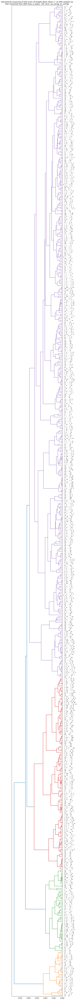

In [107]:
## term の階層クラスタリング: max_n_topics の値に拠ってparameters の最適値は異なる
## なるべく高い lowerst_density の設定が肝
HDP_helper.hc_clustering_terms_from_hdp (pair_hdp, pair_diction, term_type = term_type, n_topics= max_n_topics, lowest_density = 0.001, sampling_rate = 0.33, gap_mark = gap_mark, use_CJK = False, check = False)

In [108]:
%%capture --no-display

## LDA のtopic ごとに，関連度の高い term を表示
import pandas as pd
n_terms = n_terms_to_show # topic ごとに表示する term 数の指定
print(f"n_terms_to_show: {n_terms_to_show}")

pair_topic_dfs = [ ]
for topic_id in range(max_n_topics):
    print(f"topic_id: {topic_id}")
    pair_terms = [ ]
    if use_HDP:
        for i, prob in pair_lda.show_topics(topic_id, num_words = n_terms):
            pair_terms.append(pair_diction.id2token[int(i)])
    else:
        for i, prob in model_used.get_topic_terms(topic_id, topn = n_terms):
            pair_terms.append(pair_diction.id2token[int(i)])
    pair_topic_dfs.append(pd.DataFrame([pair_terms], index = [ f'topic {topic_id}' ]))
#
df_terms_by_topics = pd.concat(pair_topic_dfs)

## Table として表示
#df_terms_by_topics.T
df_terms_by_topics

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
topic 0,#…o… :: #…ː…,#…o… :: #…ɡ…,#…o… :: #…d…ː…,#…o… :: #d…,#…og… :: …ɡ…#,#…og… :: #…ɡ…,#…g… :: …ː…#,#…g… :: …ɡ…x…,#…g… :: …ɡ…x#,#…g… :: …ɡ…#,...,#…dí… :: #d…,#d… :: …ɡ…#,#d… :: #…ɡ…,#d… :: …x#,#d… :: …d…ɡ…,#d… :: #…ː…,#d… :: …d…ː…,#d… :: #…d…ː…,#d… :: #…d…ɡ…,#d… :: #d…
topic 1,#d… :: #d…,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
topic 2,#…o… :: #…ː…,#d… :: #d…,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
topic 3,#…o… :: #…ː…,#d… :: #…d…ɡ…,#d… :: #d…,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
topic 4,#…o… :: #…ː…,#…o… :: #…ɡ…,#d… :: #…d…ɡ…,#d… :: #d…,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
topic 5,#…o… :: #…ː…,#…o… :: #…ɡ…,#d… :: #…d…ː…,#d… :: #…d…ɡ…,#d… :: #d…,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
topic 6,#…o… :: #…ː…,#…o… :: #…ɡ…,#…o… :: #…d…ː…,#d… :: #…d…ː…,#d… :: #…d…ɡ…,#d… :: #d…,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
topic 7,#…o… :: #…ː…,#…o… :: #…ɡ…,#…o… :: #…d…ː…,#d… :: …d…ː…,#d… :: #…d…ː…,#d… :: #…d…ɡ…,#d… :: #d…,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
topic 8,#…o… :: #…ː…,#…o… :: #…ɡ…,#…o… :: #…d…ː…,#…o… :: #d…,#d… :: …d…ː…,#d… :: #…d…ː…,#d… :: #…d…ɡ…,#d… :: #d…,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
topic 9,#…o… :: #…ː…,#…o… :: #…ɡ…,#…o… :: #…d…ː…,#…o… :: #d…,#d… :: #…ː…,#d… :: …d…ː…,#d… :: #…d…ː…,#d… :: #…d…ɡ…,#d… :: #d…,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
